In [2]:
import os 
import pandas as pd 
import numpy as np


class FolderReader:
    def __init__(self, folder_path):
        self.folder_path = folder_path
        self.dataframes = []

    def read_dataframes(self):
        for archivo in os.listdir(self.folder_path):
            if archivo.endswith('.csv'):
                ruta_archivo = os.path.join(self.folder_path, archivo)
                df = pd.read_csv(ruta_archivo)
                self.dataframes.append(df)

    def get_dataframe(self, index):
        if 0 <= index < len(self.dataframes):
            return self.dataframes[index]
        else:
            return None

    def get_dataframe_names(self):
        return [df.columns.tolist() for df in self.dataframes]

carpeta = '../Data' 

folder_reader = FolderReader(carpeta)
folder_reader.read_dataframes()

df = pd.concat(folder_reader.dataframes)

emg_names = ['EMG_CHANNEL_' + str(i+1) for i in range(0,8)]
targets = ["THUMBFLEX1","THUMBFLEX2","INDEXFLEX1","INDEXFLEX2","INDEXFLEX3","MIDDLEFLEX1","MIDDLEFLEX2","MIDDLEFLEX3","RINGFLEX1","RINGFLEX2","RINGFLEX3",
           "LITTLEFLEX1","LITTLEFLEX2","LITTLEFLEX3"]

total_cols = emg_names + targets

df_emg_channels = df[total_cols]
df_emg_channels

,EMG_CHANNEL_1,EMG_CHANNEL_2,EMG_CHANNEL_3,EMG_CHANNEL_4,EMG_CHANNEL_5,EMG_CHANNEL_6,EMG_CHANNEL_7,EMG_CHANNEL_8,THUMBFLEX1,THUMBFLEX2,...,INDEXFLEX3,MIDDLEFLEX1,MIDDLEFLEX2,MIDDLEFLEX3,RINGFLEX1,RINGFLEX2,RINGFLEX3,LITTLEFLEX1,LITTLEFLEX2,LITTLEFLEX3
0,1.00000,-7.00000,-1.00000,3.0000,0.00000,-1.00000,0.00000,-2.00000,17.025000,17.025000,...,10.058000,13.840000,23.412400,19.706200,11.880000,19.755900,17.878000,13.100000,24.407100,12.203600
1,-0.56250,-0.75000,11.50000,-0.1250,-0.78125,-0.21875,-0.78125,-0.43750,17.025000,17.025000,...,10.058000,13.840000,23.412626,19.706313,11.880629,19.756719,17.878409,13.100629,24.407237,12.203668
2,-0.43750,-0.12500,6.00000,-1.0000,-1.00000,0.56250,0.68750,-1.12500,17.025000,17.025000,...,10.058000,13.840000,23.412851,19.706426,11.881258,19.757539,17.878818,13.101258,24.407375,12.203737
3,0.34375,-1.34375,4.15625,-0.3125,-0.65625,0.31250,0.96875,-1.65625,17.025000,17.025000,...,10.058000,13.840000,23.413077,19.706540,11.881887,19.758358,17.879226,13.101887,24.407512,12.203805
4,0.62500,-1.75000,10.62500,0.5000,-0.12500,-0.87500,-0.87500,-0.87500,17.025000,17.025000,...,10.058000,13.840000,23.413302,19.706653,11.882516,19.759177,17.879635,13.102516,24.407650,12.203873
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81899,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.445281,14.445281,...,12.164114,9.620203,24.324882,20.162391,2.130121,13.066502,14.533210,14.443207,24.307996,12.154038
81900,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.443125,14.443125,...,12.164489,9.637812,24.325788,20.162844,2.047734,12.957959,14.478938,14.442578,24.309705,12.154894
81901,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.440969,14.440969,...,12.164865,9.655422,24.326693,20.163297,1.965348,12.849416,14.424666,14.441949,24.311415,12.155749
81902,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.438813,14.438813,...,12.165240,9.673031,24.327599,20.163749,1.882961,12.740873,14.370394,14.441320,24.313125,12.156604


In [3]:
df_emg_channels[targets].max()

THUMBFLEX1     17.80493
THUMBFLEX2     17.80493
INDEXFLEX1     60.00000
INDEXFLEX2     75.00000
INDEXFLEX3     37.50000
MIDDLEFLEX1    50.00000
MIDDLEFLEX2    75.00000
MIDDLEFLEX3    29.50000
RINGFLEX1      50.00000
RINGFLEX2      75.00000
RINGFLEX3      29.50000
LITTLEFLEX1    45.00000
LITTLEFLEX2    75.00000
LITTLEFLEX3    37.50000
dtype: float64

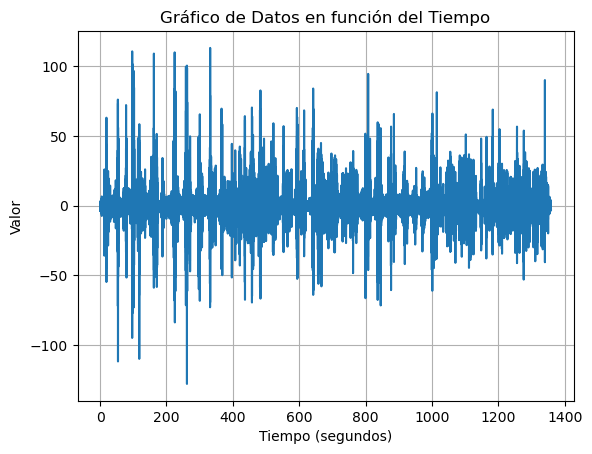

In [3]:
import matplotlib.pyplot as plt

fs = 256
ts = 1/256


eje_tiempo = np.linspace(0, df.shape[0]/fs, df.shape[0])

plt.plot(eje_tiempo, df[['EMG_CHANNEL_1']].reset_index(drop=True)) 
plt.xlabel('Tiempo (segundos)')
plt.ylabel('Valor')
plt.title('Gráfico de Datos en función del Tiempo')
plt.grid(True)
plt.show() 

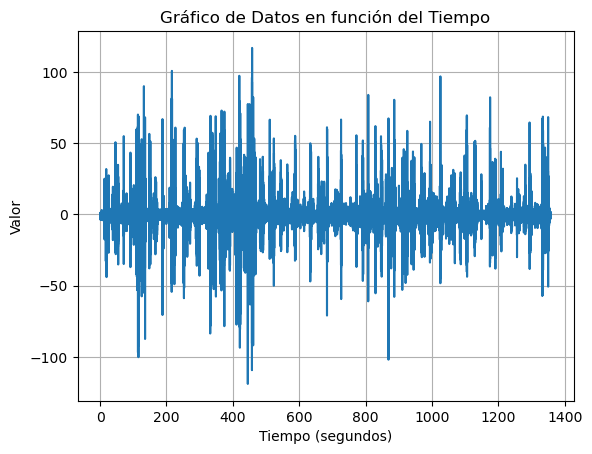

In [4]:

plt.plot(eje_tiempo, df[['EMG_CHANNEL_8']].reset_index(drop=True)) 
plt.xlabel('Tiempo (segundos)')
plt.ylabel('Valor')
plt.title('Gráfico de Datos en función del Tiempo')
plt.grid(True)
plt.show() 

In [5]:
(df.shape[0]/256)

1358.4375

In [4]:
import numpy as np
import biosppy.signals.emg as bse
from scipy.fft import fft
from scipy.signal import welch

fs_emg = 256
seconds = 4
window_size = (seconds*fs_emg)  # en milisegundos

df_emg_channels = df_emg_channels.reset_index(drop=True)

windows = []

features = []
for i in range(0, len(df_emg_channels), window_size):
    window = df_emg_channels.iloc[i:i+window_size]

    for col in df_emg_channels.columns:
        ts, filtered, _ = bse.emg(signal=window[col].values, sampling_rate=256, show=False)
        window[f'{col}_mav'] = np.mean(np.abs(filtered))
        window[f'{col}_wamp'] = np.sum(np.abs(np.diff(filtered) > 0))
        window[f'{col}_var'] = np.var(filtered)
        window[f'{col}_wl'] = np.sum(np.abs(np.diff(filtered)))
        # Características frecuenciales
        fft_signal = fft(filtered)
        freqs, psd = welch(filtered, fs=fs_emg)
        max_psd_idx = np.argmax(psd)

        if np.sum(psd) == 0:
            window[f'{col}_max_psd_freq'] = 0
            window[f'{col}_max_psd_amp'] = 0
            window[f'{col}_mean_freq'] = 0
        else:
            window[f'{col}_max_psd_freq'] = freqs[max_psd_idx]
            window[f'{col}_max_psd_amp'] = psd[max_psd_idx]
            window[f'{col}_mean_freq'] = np.average(freqs, weights=psd)

    windows.append(window)

features_df = pd.concat(windows)

features_df

/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_1787/296166866.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window[f'{col}_mav'] = np.mean(np.abs(filtered))
/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_1787/296166866.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window[f'{col}_wamp'] = np.sum(np.abs(np.diff(filtered) > 0))
/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_1787/296166866.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

,EMG_CHANNEL_1,EMG_CHANNEL_2,EMG_CHANNEL_3,EMG_CHANNEL_4,EMG_CHANNEL_5,EMG_CHANNEL_6,EMG_CHANNEL_7,EMG_CHANNEL_8,THUMBFLEX1,THUMBFLEX2,...,LITTLEFLEX2_max_psd_freq,LITTLEFLEX2_max_psd_amp,LITTLEFLEX2_mean_freq,LITTLEFLEX3_mav,LITTLEFLEX3_wamp,LITTLEFLEX3_var,LITTLEFLEX3_wl,LITTLEFLEX3_max_psd_freq,LITTLEFLEX3_max_psd_amp,LITTLEFLEX3_mean_freq
0,1.00000,-7.00000,-1.00000,3.0000,0.00000,-1.00000,0.00000,-2.00000,17.025000,17.025000,...,107.0,3.450502e-14,113.749542,7.648836e-08,511,1.547397e-13,0.000153,107.0,8.566384e-15,113.745596
1,-0.56250,-0.75000,11.50000,-0.1250,-0.78125,-0.21875,-0.78125,-0.43750,17.025000,17.025000,...,107.0,3.450502e-14,113.749542,7.648836e-08,511,1.547397e-13,0.000153,107.0,8.566384e-15,113.745596
2,-0.43750,-0.12500,6.00000,-1.0000,-1.00000,0.56250,0.68750,-1.12500,17.025000,17.025000,...,107.0,3.450502e-14,113.749542,7.648836e-08,511,1.547397e-13,0.000153,107.0,8.566384e-15,113.745596
3,0.34375,-1.34375,4.15625,-0.3125,-0.65625,0.31250,0.96875,-1.65625,17.025000,17.025000,...,107.0,3.450502e-14,113.749542,7.648836e-08,511,1.547397e-13,0.000153,107.0,8.566384e-15,113.745596
4,0.62500,-1.75000,10.62500,0.5000,-0.12500,-0.87500,-0.87500,-0.87500,17.025000,17.025000,...,107.0,3.450502e-14,113.749542,7.648836e-08,511,1.547397e-13,0.000153,107.0,8.566384e-15,113.745596
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347755,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.445281,14.445281,...,113.0,3.862786e-10,113.924662,7.179173e-06,315,1.498730e-09,0.008729,113.0,9.656672e-11,113.924651
347756,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.443125,14.443125,...,113.0,3.862786e-10,113.924662,7.179173e-06,315,1.498730e-09,0.008729,113.0,9.656672e-11,113.924651
347757,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.440969,14.440969,...,113.0,3.862786e-10,113.924662,7.179173e-06,315,1.498730e-09,0.008729,113.0,9.656672e-11,113.924651
347758,-3.00000,-2.00000,5.00000,14.0000,-3.00000,-3.00000,-1.00000,0.00000,14.438813,14.438813,...,113.0,3.862786e-10,113.924662,7.179173e-06,315,1.498730e-09,0.008729,113.0,9.656672e-11,113.924651


In [7]:
from scipy.fft import fft
from scipy.signal import welch
from sklearn.preprocessing import StandardScaler

fs_emg = 256
seconds = 1
window_size = (seconds*fs_emg)  # en milisegundos

df_emg_channels = df_emg_channels.reset_index(drop=True)

windows = []

features = []
for i in range(0, len(df_emg_channels), window_size):
    window = df_emg_channels.iloc[i:i+window_size]

    ts, filtered, _ = bse.emg(signal=window['EMG_CHANNEL_1'].values, sampling_rate=256, show=False)
    window['mav'] = np.mean(np.abs(filtered))
    window['wamp'] = np.sum(np.abs(np.diff(filtered) > 0))
    window['var'] = np.var(filtered)
    window['wl'] = np.sum(np.abs(np.diff(filtered)))
    # Características frecuenciales
    fft_signal = fft(filtered)
    freqs, psd = welch(filtered, fs=fs_emg)
    max_psd_idx = np.argmax(psd)

    window['max_psd_freq'] = freqs[max_psd_idx]
    window['max_psd_amp'] = psd[max_psd_idx]
    window['mean_freq'] = np.average(freqs, weights=psd)

    windows.append(window)

features_df = pd.concat(windows)

scaler = StandardScaler()
scaled_features_df = scaler.fit_transform(features_df)

scaled_features_df = pd.DataFrame(scaled_features_df, columns=features_df.columns)

scaled_features_df


/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_9250/1896658055.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window['mav'] = np.mean(np.abs(filtered))
/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_9250/1896658055.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window['wamp'] = np.sum(np.abs(np.diff(filtered) > 0))
/var/folders/8l/1n8nw8712ssfv4m1tjmf5ykd2c6n2q/T/ipykernel_9250/1896658055.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

,EMG_CHANNEL_1,EMG_CHANNEL_2,EMG_CHANNEL_3,EMG_CHANNEL_4,EMG_CHANNEL_5,EMG_CHANNEL_6,EMG_CHANNEL_7,EMG_CHANNEL_8,THUMBFLEX1,THUMBFLEX2,...,LITTLEFLEX1,LITTLEFLEX2,LITTLEFLEX3,mav,wamp,var,wl,max_psd_freq,max_psd_amp,mean_freq
0,0.354016,-0.598586,-0.001055,0.455694,0.249306,-0.113695,0.328875,-0.294478,0.689391,0.689391,...,-0.588580,-0.093938,-0.093927,-0.728047,-0.819848,-0.448995,-0.728212,1.830347,-0.429213,-0.063097
1,0.034945,0.011088,0.972707,0.079501,0.010199,0.279257,-0.017651,0.072693,0.689391,0.689391,...,-0.588478,-0.093922,-0.093912,-0.728047,-0.819848,-0.448995,-0.728212,1.830347,-0.429213,-0.063097
2,0.060471,0.072056,0.544251,-0.025833,-0.056751,0.672209,0.633819,-0.088862,0.689391,0.689391,...,-0.588376,-0.093907,-0.093897,-0.728047,-0.819848,-0.448995,-0.728212,1.830347,-0.429213,-0.063097
3,0.220006,-0.046831,0.400621,0.056929,0.048456,0.546464,0.758568,-0.213701,0.689391,0.689391,...,-0.588274,-0.093892,-0.093882,-0.728047,-0.819848,-0.448995,-0.728212,1.830347,-0.429213,-0.063097
4,0.277439,-0.086460,0.904543,0.154739,0.211049,-0.050823,-0.059234,-0.030115,0.689391,0.689391,...,-0.588171,-0.093877,-0.093867,-0.728047,-0.819848,-0.448995,-0.728212,1.830347,-0.429213,-0.063097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347755,-0.462804,-0.110847,0.466350,1.779892,-0.668865,-1.119652,-0.114679,0.175501,-0.895431,-0.895431,...,-0.370307,-0.104802,-0.104793,-1.174864,-22.928665,-0.481608,-1.174288,1.973767,-0.456254,6.183470
347756,-0.462804,-0.110847,0.466350,1.779892,-0.668865,-1.119652,-0.114679,0.175501,-0.896755,-0.896755,...,-0.370409,-0.104614,-0.104606,-1.174864,-22.928665,-0.481608,-1.174288,1.973767,-0.456254,6.183470
347757,-0.462804,-0.110847,0.466350,1.779892,-0.668865,-1.119652,-0.114679,0.175501,-0.898080,-0.898080,...,-0.370511,-0.104427,-0.104418,-1.174864,-22.928665,-0.481608,-1.174288,1.973767,-0.456254,6.183470
347758,-0.462804,-0.110847,0.466350,1.779892,-0.668865,-1.119652,-0.114679,0.175501,-0.899405,-0.899405,...,-0.370613,-0.104240,-0.104231,-1.174864,-22.928665,-0.481608,-1.174288,1.973767,-0.456254,6.183470


In [ ]:
from scipy.stats import skew, kurtosis, entropy
from scipy.fftpack import fft
from scipy.signal import welch
from numpy import mean, var, diff, abs, sign, sqrt, argmax, average
from sklearn.preprocessing import StandardScaler
from scipy.integrate import simps

for i in range(0, len(df_emg_channels), window_size):
    window = df_emg_channels.iloc[i:i+window_size]

    ts, filtered, _ = bse.emg(signal=window['EMG_CHANNEL_1'].values, sampling_rate=256, show=False)
    window['mav'] = mean(abs(filtered))
    window['wamp'] = sum(abs(diff(filtered)) > 0)
    window['var'] = var(filtered)
    window['wl'] = sum(abs(diff(filtered)))
    window['rms'] = sqrt(mean(filtered**2))
    window['zc'] = ((filtered[:-1] * filtered[1:]) < 0).sum()
    window['ssc'] = diff(sign(diff(filtered))).sum()
    window['skewness'] = skew(filtered)
    window['kurtosis'] = kurtosis(filtered)
    # Características frecuenciales
    fft_signal = fft(filtered)
    freqs, psd = welch(filtered, fs=fs_emg)
    max_psd_idx = argmax(psd)

    window['max_psd_freq'] = freqs[max_psd_idx]
    window['max_psd_amp'] = psd[max_psd_idx]
    window['mean_freq'] = average(freqs, weights=psd)
    window['med_freq'] = freqs[len(freqs)//2]
    # Nuevas características
    window['energy'] = sum(filtered**2)
    window['entropy'] = entropy(abs(fft_signal))
    window['fundamental_freq'] = freqs[argmax(abs(fft_signal))]

    windows.append(window)

features_df = pd.concat(windows)

scaler = StandardScaler()
scaled_features_df = scaler.fit_transform(features_df)

scaled_features_df = pd.DataFrame(scaled_features_df, columns=features_df.columns)

In [7]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

X = features_df.drop(targets, axis=1)
y = df_emg_channels[targets]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Linear Regression
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)
y_pred_test_linear = linear_reg.predict(X_test)

# Ridge Regression
param_grid_ridge = {
    'alpha': [0.1, 1, 10],
    'max_iter': [1000, 5000, 10000]
}

ridge = Ridge()

grid_search_ridge = GridSearchCV(ridge, param_grid_ridge, cv=5, scoring='neg_mean_squared_error')
grid_search_ridge.fit(X_train, y_train)

best_params_ridge = grid_search_ridge.best_params_
best_model_ridge = grid_search_ridge.best_estimator_

y_pred_test_ridge = best_model_ridge.predict(X_test)

# Lasso Regression
param_grid_lasso = {
    'alpha': [0.1, 1, 10],
    'max_iter': [1000, 5000, 10000]
}

lasso = Lasso()

grid_search_lasso = GridSearchCV(lasso, param_grid_lasso, cv=5, scoring='neg_mean_squared_error')
grid_search_lasso.fit(X_train, y_train)

best_params_lasso = grid_search_lasso.best_params_
best_model_lasso = grid_search_lasso.best_estimator_

y_pred_test_lasso = best_model_lasso.predict(X_test)

# ElasticNet Regression
param_grid_elasticnet = {
    'alpha': [0.1, 1, 10],
    'l1_ratio': [0.1, 0.5, 0.9],
    'max_iter': [1000, 5000, 10000]
}

elasticnet = ElasticNet()

grid_search_elasticnet = GridSearchCV(elasticnet, param_grid_elasticnet, cv=5, scoring='neg_mean_squared_error')
grid_search_elasticnet.fit(X_train, y_train)

best_params_elasticnet = grid_search_elasticnet.best_params_
best_model_elasticnet = grid_search_elasticnet.best_estimator_

y_pred_test_elasticnet = best_model_elasticnet.predict(X_test)

/Users/nikrodriguez/anaconda3/envs/master/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.415e+07, tolerance: 4.519e+03
  model = cd_fast.enet_coordinate_descent(
/Users/nikrodriguez/anaconda3/envs/master/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.895e+06, tolerance: 4.675e+03
  model = cd_fast.enet_coordinate_descent(
/Users/nikrodriguez/anaconda3/envs/master/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of 

KeyboardInterrupt: 

In [9]:
mae_linear = mean_absolute_error(y_test, y_pred_test_linear)
mae_ridge = mean_absolute_error(y_test, y_pred_test_ridge)
mae_lasso = mean_absolute_error(y_test, y_pred_test_lasso)
mae_elasticnet = mean_absolute_error(y_test, y_pred_test_elasticnet)
print("MAE en el conjunto de test linear:", mae_linear)
print("MAE en el conjunto de test ridge:", mae_ridge)
print("MAE en el conjunto de test lasso:", mae_lasso)
print("MAE en el conjunto de test elasticnet:", mae_elasticnet)

MAE en el conjunto de test linear: 5.1959025956270315
MAE en el conjunto de test ridge: 5.195930327713101
MAE en el conjunto de test lasso: 5.19328967381641
MAE en el conjunto de test elasticnet: 5.196411910506519


In [8]:
from sklearn.ensemble import RandomForestRegressor


rf = RandomForestRegressor()

rf.fit(X_train, y_train)


y_pred_test_rf = rf.predict(X_test)

In [11]:
mae_rf = mean_absolute_error(y_test, y_pred_test_rf)
print("MAE en el conjunto de test:", mae_rf)

MAE en el conjunto de test: 1.0695833413830789


In [69]:
import xgboost as xgb
from sklearn.model_selection import train_test_split

model_xgb = xgb.XGBRegressor()

model_xgb.fit(X_train, y_train)

y_pred_test_xgb = model_xgb.predict(X_test)

In [70]:
mae_xgb = mean_absolute_error(y_test, y_pred_test_xgb)
print("MAE en el conjunto de test:", mae_xgb)

MAE en el conjunto de test: 1.511422755939995


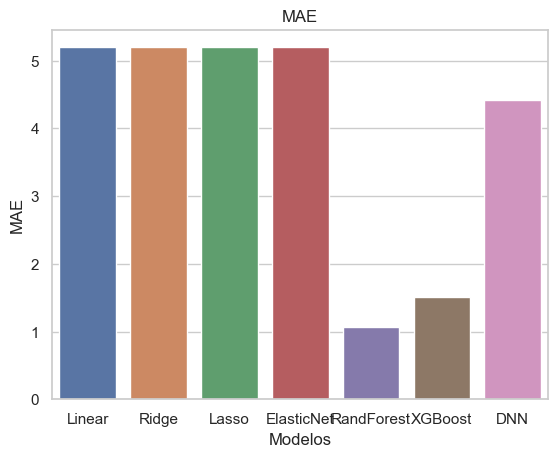

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

metricas = {
    'Linear': mae_linear,
    'Ridge': mae_ridge,
    'Lasso': mae_lasso,
    'ElasticNet': mae_elasticnet,
    'RandForest': mae_rf,
    'XGBoost': mae_xgb,
    'DNN': 4.423
}

# Define la paleta de colores


# Grafica las barras con la paleta de colores personalizada
sns.barplot(x=list(metricas.keys()), y=list(metricas.values()))
sns.set_style("whitegrid")
# Configura el título y los ejes
plt.title('MAE')
plt.xlabel('Modelos')
plt.ylabel('MAE')

plt.show()



In [9]:
y_pred_test = rf.predict(X_test)

df_test = pd.DataFrame(y_pred_test, columns=targets)
y_test = y_test.reset_index(drop=True)

df_diff = (y_test - df_test).abs()
df_diff

,THUMBFLEX1,THUMBFLEX2,INDEXFLEX1,INDEXFLEX2,INDEXFLEX3,MIDDLEFLEX1,MIDDLEFLEX2,MIDDLEFLEX3,RINGFLEX1,RINGFLEX2,RINGFLEX3,LITTLEFLEX1,LITTLEFLEX2,LITTLEFLEX3
0,0.067778,0.067778,3.954128,0.098598,0.049283,3.621564,0.028092,0.014030,1.788599,1.028237,0.514113,2.266280,0.003369,0.001690
1,0.076509,0.076509,1.762103,0.010363,0.005245,2.632805,0.137466,0.068755,0.203291,6.365531,4.333279,0.009552,0.025271,0.012642
2,0.245745,0.245745,0.413348,0.025754,0.012924,1.054036,0.669197,0.342121,0.609687,0.067608,0.033855,0.412155,0.047787,0.023933
3,0.645757,0.645757,13.826224,2.828796,1.414365,6.948530,8.963132,4.278469,11.840444,0.422805,0.211415,6.527758,2.144939,1.072478
4,0.140009,0.140009,0.887445,1.330264,0.665130,0.804823,0.080566,0.040284,0.609309,0.092815,0.046427,0.499070,0.003812,0.001895
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69547,0.013617,0.013617,0.226894,0.073107,0.036565,0.095099,0.026022,0.012976,0.035865,0.095298,0.047653,0.102053,0.014302,0.007131
69548,0.181132,0.181132,0.823851,0.637985,0.318982,1.509656,0.205247,0.102610,1.217235,0.134647,0.067307,1.005645,0.016665,0.008327
69549,0.190223,0.190223,0.148323,0.013775,0.006888,0.137802,0.031645,0.015851,1.263499,7.002269,0.149640,0.809068,0.008217,0.004061
69550,0.114943,0.114943,0.064353,0.029434,0.014724,0.125283,0.192881,0.096477,1.560321,2.692256,1.346087,0.203535,0.002672,0.001335


In [18]:
y_test.head()

,THUMBFLEX1,THUMBFLEX2,INDEXFLEX1,INDEXFLEX2,INDEXFLEX3,MIDDLEFLEX1,MIDDLEFLEX2,MIDDLEFLEX3,RINGFLEX1,RINGFLEX2,RINGFLEX3,LITTLEFLEX1,LITTLEFLEX2,LITTLEFLEX3
0,15.166330,15.166330,34.805633,21.902400,10.951200,15.228047,24.260400,20.130200,1.532988,20.123520,18.061728,1.805172,24.768540,12.384302
1,15.607406,15.607406,3.237000,24.820889,12.410407,3.783187,24.137209,20.068604,8.255094,24.642708,20.321317,18.594562,24.371875,12.185975
2,15.828750,15.828750,6.692500,24.983650,12.491869,10.278750,22.295406,19.147750,17.029375,24.705381,20.352644,23.131875,23.972100,11.986100
3,12.132715,12.132715,55.056523,55.631835,27.815885,34.362520,37.189606,10.594803,48.507168,58.076898,21.038449,29.239062,28.813362,14.406681
4,16.919033,16.919033,4.727441,23.697435,11.848718,17.699023,24.642262,20.321128,17.834512,24.310024,20.155059,20.730000,24.375900,12.188000


In [19]:
df_test.head()

,THUMBFLEX1,THUMBFLEX2,INDEXFLEX1,INDEXFLEX2,INDEXFLEX3,MIDDLEFLEX1,MIDDLEFLEX2,MIDDLEFLEX3,RINGFLEX1,RINGFLEX2,RINGFLEX3,LITTLEFLEX1,LITTLEFLEX2,LITTLEFLEX3
0,15.234108,15.234108,30.851504,22.000998,11.000483,11.606483,24.232308,20.116170,3.321587,19.095283,17.547615,4.071452,24.765171,12.382612
1,15.683915,15.683915,1.474897,24.831252,12.415652,6.415992,24.274675,20.137360,8.458385,18.277177,15.988037,18.585011,24.397146,12.198617
2,16.074495,16.074495,7.105848,24.957896,12.478945,11.332786,22.964603,18.805629,17.639062,24.772989,20.386499,23.544030,23.924313,11.962167
3,12.778472,12.778472,41.230299,52.803040,26.401520,27.413989,28.226474,6.316334,36.666724,57.654093,20.827033,22.711304,26.668423,13.334204
4,16.779025,16.779025,3.839996,25.027699,12.513848,16.894200,24.561697,20.280844,17.225203,24.217209,20.108631,20.230930,24.379712,12.189895


In [65]:
df_diff_means = df_diff.mean()
pd.DataFrame(df_diff_means).reset_index().rename(columns={'index': 'target', 0: 'mean_diff'})

,target,mean_diff
0,THUMBFLEX1,0.116857
1,THUMBFLEX2,0.116857
2,INDEXFLEX1,1.671410
3,INDEXFLEX2,1.768913
4,INDEXFLEX3,0.884456
5,MIDDLEFLEX1,1.297904
6,MIDDLEFLEX2,1.254740
7,MIDDLEFLEX3,0.641721
8,RINGFLEX1,1.098114
9,RINGFLEX2,2.370908


In [72]:
def graficar_metricas_por_modelo(model, X_test, y_test):
    y_pred_test = model.predict(X_test)

    df_test = pd.DataFrame(y_pred_test, columns=targets)
    y_test = y_test.reset_index(drop=True)

    df_diff = (y_test - df_test).abs()
    return df_diff

modelos = [linear_reg, best_model_ridge, best_model_lasso, best_model_elasticnet, rf, model_xgb, best_model_elasticnet]
nombres_modelos = ['Linear', 'Ridge', 'Lasso', 'ElasticNet', 'RandForest', 'XGBoost', 'DNN']

df_resultados = []

for model, nombre in zip(modelos, nombres_modelos):
    df_resultado = graficar_metricas_por_modelo(model, X_test, y_test)
    df_diff_means = df_resultado.mean()
    df_resultado_means = pd.DataFrame(df_diff_means).reset_index().rename(columns={'index': 'target', 0: 'mean_diff'})
    df_resultado_means['Modelo'] = nombre
    df_resultados.append(df_resultado_means)

df_resultados_total = pd.concat(df_resultados)
df_resultados_total

,target,mean_diff,Modelo
0,THUMBFLEX1,0.986459,Linear
1,THUMBFLEX2,0.986459,Linear
2,INDEXFLEX1,10.287758,Linear
3,INDEXFLEX2,10.422471,Linear
4,INDEXFLEX3,5.211236,Linear
...,...,...,...
9,RINGFLEX2,12.315559,DNN
10,RINGFLEX3,3.558559,DNN
11,LITTLEFLEX1,4.460166,DNN
12,LITTLEFLEX2,4.100520,DNN


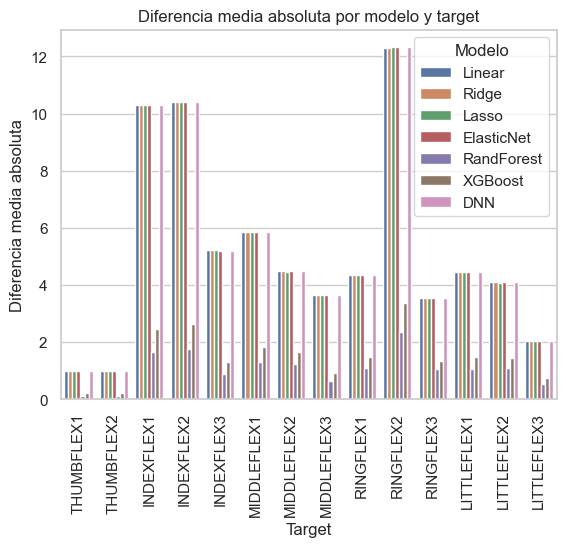

In [73]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("whitegrid")

# Graficar los datos
sns.barplot(x='target', y='mean_diff', hue='Modelo', data=df_resultados_total)

# Configurar el título y los ejes
plt.title('Diferencia media absoluta por modelo y target')
plt.xlabel('Target')
plt.ylabel('Diferencia media absoluta')

# Girar los nombres del eje x verticalmente
plt.xticks(rotation=90)

# Mostrar el gráfico
plt.show()

In [95]:
import time

modelos = [linear_reg, best_model_ridge, best_model_lasso, best_model_elasticnet, rf, model_xgb, best_model_elasticnet]
nombres_modelos = ['Linear', 'Ridge', 'Lasso', 'ElasticNet', 'RandForest', 'XGBoost', 'DNN']

def grficar_tiempos_inferencia(modelos, nombres_modelos):
    tiempos_inferencia = []
    nombres = []
    for model, nombre in zip(modelos, nombres_modelos):
        start = time.time()
        model.predict(X_test.head(1))
        end = time.time()
        tiempo_inferencia = end - start
        tiempos_inferencia.append(tiempo_inferencia)
        nombres.append(nombre)
    return tiempos_inferencia, nombres

tiempos_inferencia, nombres = grficar_tiempos_inferencia(modelos, nombres_modelos)
tiempos_inferencia_dict = {nombre: tiempo_inferencia for nombre, tiempo_inferencia in zip(nombres, tiempos_inferencia)}
tiempos_inferencia_dict

{'Linear': 0.003637075424194336,
 'Ridge': 0.001007080078125,
 'Lasso': 0.0007648468017578125,
 'ElasticNet': 0.0006337165832519531,
 'RandForest': 0.023370027542114258,
 'XGBoost': 0.008164167404174805,
 'DNN': 0.0011479854583740234}

In [95]:
targets

['THUMBFLEX1',
 'THUMBFLEX2',
 'INDEXFLEX1',
 'INDEXFLEX2',
 'INDEXFLEX3',
 'MIDDLEFLEX1',
 'MIDDLEFLEX2',
 'MIDDLEFLEX3',
 'RINGFLEX1',
 'RINGFLEX2',
 'RINGFLEX3',
 'LITTLEFLEX1',
 'LITTLEFLEX2',
 'LITTLEFLEX3']

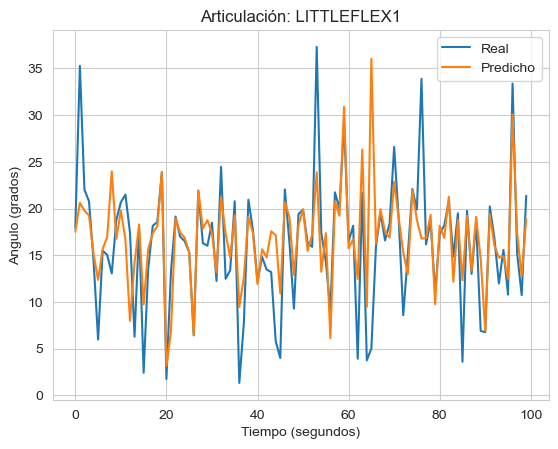

In [17]:
articulacion = 'LITTLEFLEX1'

plt.plot(y_test[[articulacion]].iloc[4000:4100].reset_index(drop=True), label='Real')
plt.plot(df_test[[articulacion]].iloc[4000:4100].reset_index(drop=True), label='Predicho') 

plt.xlabel('Tiempo (segundos)')
plt.ylabel('Angulo (grados)')
plt.legend(loc='upper right')
plt.title('Articulación: ' + articulacion)
plt.grid(True)
plt.show()


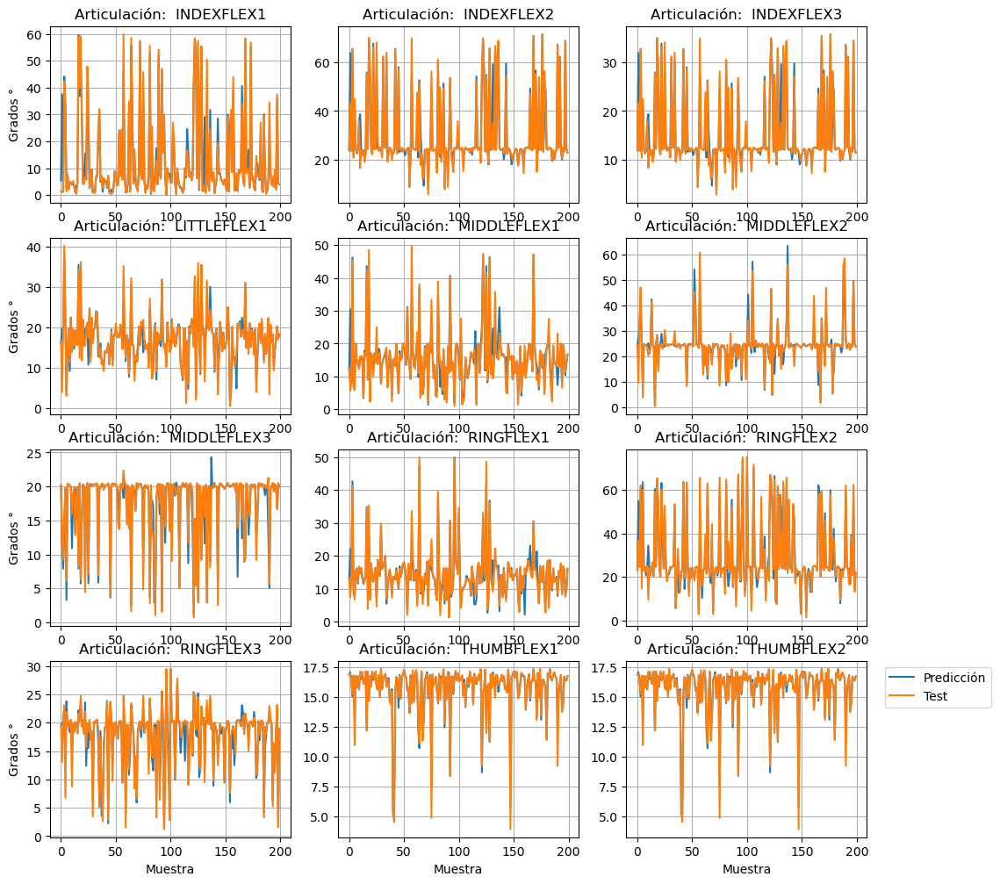

In [18]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(4, 3, figsize=(12, 12))

for i in range(4):
    for j in range(3):

        articulacion = targets_sorted[i*3 + j]

        ax = axs[i, j]

        ax.plot(df_test[[articulacion]].iloc[2000:2200].reset_index(drop=True), label='Predicción') 
        ax.plot(y_test[[articulacion]].iloc[2000:2200].reset_index(drop=True), label='Test')

        if j == 0:
            ax.set_ylabel('Grados °')
        if i == 3:
            ax.set_xlabel('Muestra')
        
        ax.set_title(f'Articulación:  {articulacion}')
        ax.grid(True)

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()